In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
feargreed_data = pd.read_csv('fear_greed_index.csv')
historical_data = pd.read_csv('historical_data.csv')

print("feargreed_data shape : ",feargreed_data.shape)
print("Historical data shape : ",historical_data.shape)

feargreed_data shape :  (2644, 4)
Historical data shape :  (211224, 16)


In [4]:
feargreed_data.head(5)

,timestamp,value,classification,date
0,1517463000,30,Fear,2018-02-01
1,1517549400,15,Extreme Fear,2018-02-02
2,1517635800,40,Fear,2018-02-03
3,1517722200,24,Extreme Fear,2018-02-04
4,1517808600,11,Extreme Fear,2018-02-05


In [5]:
historical_data.head(5)

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Timestamp IST,Start Position,Direction,Closed PnL,Transaction Hash,Order ID,Crossed,Fee,Trade ID,Timestamp
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,02-12-2024 22:50,0.000000,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.345404,8.950000e+14,1.730000e+12
1,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9800,16.00,127.68,BUY,02-12-2024 22:50,986.524596,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.005600,4.430000e+14,1.730000e+12
2,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9855,144.09,1150.63,BUY,02-12-2024 22:50,1002.518996,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.050431,6.600000e+14,1.730000e+12
3,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9874,142.98,1142.04,BUY,02-12-2024 22:50,1146.558564,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.050043,1.080000e+15,1.730000e+12
4,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9894,8.73,69.75,BUY,02-12-2024 22:50,1289.488521,Buy,0.0,0xec09451986a1874e3a980418412fcd0201f500c95bac...,52017706630,True,0.003055,1.050000e+15,1.730000e+12


In [6]:
historical_data.drop(['Transaction Hash','Order ID', 'Trade ID', 'Timestamp'], axis=1, inplace=True)

## Merging the dataframes
Each trade (at HH:MM resolution from historical_data) gets the most recent available sentiment from the feargreed_data.

In [7]:
def merge_with_sentiment(historical_data: pd.DataFrame, feargreed_data: pd.DataFrame) -> pd.DataFrame:

  # 'Timestamp IST' converted to datetime
  historical_data['Timestamp'] = pd.to_datetime(historical_data['Timestamp IST'], format='%d-%m-%Y %H:%M')

  # date to datetime, set index
  feargreed_data['date'] = pd.to_datetime(feargreed_data['date'])
  feargreed_data.set_index('date', inplace=True)
  feargreed_data = feargreed_data.sort_index()

  # DataFrame of all unique trade timestamps
  trade_timestamps = pd.DataFrame({'Timestamp': historical_data['Timestamp'].sort_values().unique()})

  # Forward-fill sentiment to each trade timestamp
  sentiment_ffill = feargreed_data.reindex(trade_timestamps['Timestamp'], method='ffill').reset_index()
  sentiment_ffill.rename(columns={'index': 'Timestamp'}, inplace=True)

  # Merge back into historical data on Timestamp
  merged_df = pd.merge(historical_data, sentiment_ffill, how='left', on='Timestamp')
  return merged_df

In [8]:
merged_df = merge_with_sentiment(historical_data, feargreed_data)
merged_df.head(5)

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Timestamp IST,Start Position,Direction,Closed PnL,Crossed,Fee,Timestamp,timestamp,value,classification
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,02-12-2024 22:50,0.000000,Buy,0.0,True,0.345404,2024-12-02 22:50:00,1733117400,80,Extreme Greed
1,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9800,16.00,127.68,BUY,02-12-2024 22:50,986.524596,Buy,0.0,True,0.005600,2024-12-02 22:50:00,1733117400,80,Extreme Greed
2,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9855,144.09,1150.63,BUY,02-12-2024 22:50,1002.518996,Buy,0.0,True,0.050431,2024-12-02 22:50:00,1733117400,80,Extreme Greed
3,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9874,142.98,1142.04,BUY,02-12-2024 22:50,1146.558564,Buy,0.0,True,0.050043,2024-12-02 22:50:00,1733117400,80,Extreme Greed
4,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9894,8.73,69.75,BUY,02-12-2024 22:50,1289.488521,Buy,0.0,True,0.003055,2024-12-02 22:50:00,1733117400,80,Extreme Greed


In [9]:
merged_df.shape

(211224, 16)

In [10]:
merged_df.isna().sum()

,0
Account,0
Coin,0
Execution Price,0
Size Tokens,0
Size USD,0
Side,0
Timestamp IST,0
Start Position,0
Direction,0
Closed PnL,0


No Null values

In [11]:
merged_df.head(1)

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Timestamp IST,Start Position,Direction,Closed PnL,Crossed,Fee,Timestamp,timestamp,value,classification
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,02-12-2024 22:50,0.0,Buy,0.0,True,0.345404,2024-12-02 22:50:00,1733117400,80,Extreme Greed


In [12]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 211224 entries, 0 to 211223
Data columns (total 16 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   Account          211224 non-null  object        
 1   Coin             211224 non-null  object        
 2   Execution Price  211224 non-null  float64       
 3   Size Tokens      211224 non-null  float64       
 4   Size USD         211224 non-null  float64       
 5   Side             211224 non-null  object        
 6   Timestamp IST    211224 non-null  object        
 7   Start Position   211224 non-null  float64       
 8   Direction        211224 non-null  object        
 9   Closed PnL       211224 non-null  float64       
 10  Crossed          211224 non-null  bool          
 11  Fee              211224 non-null  float64       
 12  Timestamp        211224 non-null  datetime64[ns]
 13  timestamp        211224 non-null  int64         
 14  value            211

In [13]:
merged_df.describe()

,Execution Price,Size Tokens,Size USD,Start Position,Closed PnL,Fee,Timestamp,timestamp,value
count,211224.000000,2.112240e+05,2.112240e+05,2.112240e+05,211224.000000,211224.000000,211224,2.112240e+05,211224.000000
mean,11414.723350,4.623365e+03,5.639451e+03,-2.994625e+04,48.749001,1.163967,2025-01-31 12:04:22.915009792,1.738301e+09,51.650234
min,0.000005,8.740000e-07,0.000000e+00,-1.433463e+07,-117990.104100,-1.175712,2023-05-01 01:06:00,1.682919e+09,10.000000
25%,4.854700,2.940000e+00,1.937900e+02,-3.762311e+02,0.000000,0.016121,2024-12-31 21:00:45,1.735623e+09,33.000000
50%,18.280000,3.200000e+01,5.970450e+02,8.472793e+01,0.000000,0.089578,2025-02-24 18:55:00,1.740375e+09,49.000000
75%,101.580000,1.879025e+02,2.058960e+03,9.337278e+03,5.792797,0.393811,2025-04-02 18:22:00,1.743572e+09,72.000000
max,109004.000000,1.582244e+07,3.921431e+06,3.050948e+07,135329.090100,837.471593,2025-05-01 12:13:00,1.746077e+09,94.000000
std,29447.654868,1.042729e+05,3.657514e+04,6.738074e+05,919.164828,6.758854,NaN,8.029314e+06,21.012765


In [14]:
merged_df.drop(['Timestamp IST', 'timestamp'], axis=1, inplace=True)
merged_df['Timestamp'] = pd.to_datetime(merged_df['Timestamp'], format='%d-%m-%Y %H:%M')
merged_df.head(1)

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Start Position,Direction,Closed PnL,Crossed,Fee,Timestamp,value,classification
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,0.0,Buy,0.0,True,0.345404,2024-12-02 22:50:00,80,Extreme Greed


In [15]:
for i in merged_df.columns:
  if merged_df[i].dtype == 'object':
    # fix this line
    print(i, " : ", merged_df[i].unique(),"\n\n", i," has ", merged_df[i].nunique(), " values \n")

Account  :  ['0xae5eacaf9c6b9111fd53034a602c192a04e082ed'
 '0x72c6a4624e1dffa724e6d00d64ceae698af892a0'
 '0x513b8629fe877bb581bf244e326a047b249c4ff1'
 '0x083384f897ee0f19899168e3b1bec365f52a9012'
 '0x430f09841d65beb3f27765503d0f850b8bce7713'
 '0x8381e6d82f1affd39a336e143e081ef7620a3b7f'
 '0x4f93fead39b70a1824f981a54d4e55b278e9f760'
 '0x75f7eeb85dc639d5e99c78f95393aa9a5f1170d4'
 '0x420ab45e0bd8863569a5efbb9c05d91f40624641'
 '0xb1231a4a2dd02f2276fa3c5e2a2f3436e6bfed23'
 '0x23e7a7f8d14b550961925fbfdaa92f5d195ba5bd'
 '0x6d6a4b953f202f8df5bed40692e7fd865318264a'
 '0xbaaaf6571ab7d571043ff1e313a9609a10637864'
 '0xaf40fdc468c30116bd3307bcbf4a451a7ebf1deb'
 '0x3998f134d6aaa2b6a5f723806d00fd2bbbbce891'
 '0xa0feb3725a9335f49874d7cd8eaad6be45b27416'
 '0x8477e447846c758f5a675856001ea72298fd9cb5'
 '0x8170715b3b381dffb7062c0298972d4727a0a63b'
 '0x47add9a56df66b524d5e2c1993a43cde53b6ed85'
 '0x3f9a0aadc7f04a7c9d75dc1b5a6ddd6e36486cf6'
 '0x28736f43f1e871e6aa8b1148d38d4994275d72c4'
 '0x39cef799f8b69da199

- Account has 32 Unique Values
- Coin has 246 Unique Values
- Side has 2 Unique Values
- Direction has 12 Unique Values
- Classification has 5 Unique Values

We have data of 32 different people who are investing in 246 unique assets but Buying or Selling them

## Trader Performance Metrics :
- PnL  - Profit or Loss per trade (already present as Closed PnL)
- Trade Return % - Return per trade = (PnL / Size USD) * 100
- Cumulative PnL - Running total of PnL (per account or globally)

These metrics will help us decide which account is making most money

In [16]:
merged_df['PnL'] = merged_df['Closed PnL'].copy()
merged_df['Trade Return %'] = (merged_df['PnL']/merged_df['Size USD'])*100

In [17]:
merged_df.drop('Closed PnL', axis=1, inplace=True)
merged_df.head()

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Start Position,Direction,Crossed,Fee,Timestamp,value,classification,PnL,Trade Return %
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,0.000000,Buy,True,0.345404,2024-12-02 22:50:00,80,Extreme Greed,0.0,0.0
1,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9800,16.00,127.68,BUY,986.524596,Buy,True,0.005600,2024-12-02 22:50:00,80,Extreme Greed,0.0,0.0
2,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9855,144.09,1150.63,BUY,1002.518996,Buy,True,0.050431,2024-12-02 22:50:00,80,Extreme Greed,0.0,0.0
3,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9874,142.98,1142.04,BUY,1146.558564,Buy,True,0.050043,2024-12-02 22:50:00,80,Extreme Greed,0.0,0.0
4,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9894,8.73,69.75,BUY,1289.488521,Buy,True,0.003055,2024-12-02 22:50:00,80,Extreme Greed,0.0,0.0


In [18]:
account_data = merged_df.groupby('Account').agg({
        'PnL': 'sum',
        'Trade Return %': 'mean',
        'Size USD': 'sum',
        'Coin' : 'count',
        'Execution Price': 'mean',
        'value': 'first',
        'classification': 'first'
    }).reset_index().rename(columns={
        'PnL': 'Daily PnL',
        'Trade Return %': 'Avg Daily Return %',
        'Size USD': 'Volume USD',
        'Coin' : 'Trades',
        'Execution Price': 'Execution Price',
        'value': 'Sentiment Value',
        'classification': 'Sentiment Label'
    })
account_data

,Account,Daily PnL,Avg Daily Return %,Volume USD,Trades,Execution Price,Sentiment Value,Sentiment Label
0,0x083384f897ee0f19899168e3b1bec365f52a9012,1.600230e+06,3.256512,6.169726e+07,3818,2065.999872,76,Extreme Greed
1,0x23e7a7f8d14b550961925fbfdaa92f5d195ba5bd,4.788532e+04,0.107416,1.203549e+07,7280,265.622352,84,Extreme Greed
2,0x271b280974205ca63b716753467d5a371de622ab,-7.043619e+04,0.012150,3.387344e+07,3809,15953.138177,52,Neutral
3,0x28736f43f1e871e6aa8b1148d38d4994275d72c4,1.324648e+05,5.240811,6.757022e+06,13311,6537.333556,86,Extreme Greed
4,0x2c229d22b100a7beb69122eed721cee9b24011dd,1.686580e+05,2.353704,1.016688e+07,3239,18.484069,77,Extreme Greed
5,0x3998f134d6aaa2b6a5f723806d00fd2bbbbce891,-3.120360e+04,-46.263735,1.409902e+06,815,258.788891,63,Greed
6,0x39cef799f8b69da1995852eea189df24eb5cae3c,1.445692e+04,0.570785,1.719338e+07,3589,7191.119119,80,Extreme Greed
7,0x3f9a0aadc7f04a7c9d75dc1b5a6ddd6e36486cf6,5.349625e+04,4.255941,1.143896e+06,332,23370.812150,37,Fear
8,0x420ab45e0bd8863569a5efbb9c05d91f40624641,1.995056e+05,13.024413,1.987528e+06,383,29465.966261,72,Greed
9,0x430f09841d65beb3f27765503d0f850b8bce7713,4.165419e+05,13.413985,2.966109e+06,1237,4.961415,66,Greed


In [19]:
max_pnl_account = account_data.loc[account_data['Daily PnL'].idxmax()]
max_return_account = account_data.loc[account_data['Avg Daily Return %'].idxmax()]
min_pnl_account = account_data.loc[account_data['Daily PnL'].idxmin()]
min_return_account = account_data.loc[account_data['Avg Daily Return %'].idxmin()]

print("Account with Maximum Daily PnL:")
display(max_pnl_account)

print("\nAccount with Maximum Avg Daily Return %:")
display(max_return_account)

print("\nAccount with Minimum Daily PnL:")
display(min_pnl_account)

print("\nAccount with Minimum Avg Daily Return %:")
display(min_return_account)

Account with Maximum Daily PnL:


,27
Account,0xb1231a4a2dd02f2276fa3c5e2a2f3436e6bfed23
Daily PnL,2143382.597689
Avg Daily Return %,6.237844
Volume USD,56543565.23
Trades,14733
Execution Price,5610.012701
Sentiment Value,75
Sentiment Label,Extreme Greed



Account with Maximum Avg Daily Return %:


,24
Account,0xa520ded057a32086c40e7dd6ed4eb8efb82c00e0
Daily PnL,72846.484272
Avg Daily Return %,27.606413
Volume USD,861809.4
Trades,417
Execution Price,498.145845
Sentiment Value,37
Sentiment Label,Fear



Account with Minimum Daily PnL:


,19
Account,0x8170715b3b381dffb7062c0298972d4727a0a63b
Daily PnL,-167621.124781
Avg Daily Return %,4.094751
Volume USD,10143758.13
Trades,4601
Execution Price,3742.612574
Sentiment Value,87
Sentiment Label,Extreme Greed



Account with Minimum Avg Daily Return %:


,5
Account,0x3998f134d6aaa2b6a5f723806d00fd2bbbbce891
Daily PnL,-31203.599986
Avg Daily Return %,-46.263735
Volume USD,1409902.0
Trades,815
Execution Price,258.788891
Sentiment Value,63
Sentiment Label,Greed


Above we can conclude the accounts which had best and worst performance

In [20]:
datetime_df = merged_df.groupby('Timestamp').agg({
        'PnL': 'sum',
        'Trade Return %': 'mean',
        'Size USD': 'sum',
        'Coin' : 'count',
        'Execution Price': 'mean',
        'value': 'first',
        'classification': 'first'
    }).reset_index()
datetime_df

,Timestamp,PnL,Trade Return %,Size USD,Coin,Execution Price,value,classification
0,2023-05-01 01:06:00,0.000000,0.000000,477.00,3,1898.133333,63,Greed
1,2023-12-05 03:11:00,0.000000,0.000000,50005.83,9,11038.300000,75,Extreme Greed
2,2023-12-14 01:20:00,-281.804639,-1.052301,50778.40,3,29249.766667,72,Greed
3,2023-12-14 23:27:00,0.000000,0.000000,25881.63,3,99.072667,72,Greed
4,2023-12-14 23:28:00,76.369902,0.292663,25957.99,3,99.363000,72,Greed
...,...,...,...,...,...,...,...,...
27972,2025-05-01 11:42:00,-0.262890,-0.000631,74998.20,5,95093.200000,53,Neutral
27973,2025-05-01 12:02:00,-34.608030,-6.236131,554.96,1,1.037500,53,Neutral
27974,2025-05-01 12:05:00,-16.047600,-6.009662,267.03,1,1.035000,53,Neutral
27975,2025-05-01 12:10:00,-17.304040,-6.009084,287.94,3,1.035000,53,Neutral


In [21]:
#  Timestamp vs Size USD (Volume)
fig_volume = px.line(datetime_df, x='Timestamp', y='Size USD', title='Size USD Over Time')
fig_volume.show()

In [22]:
# Timestamp vs Closed PnL
fig_pnl = px.line(datetime_df, x='Timestamp', y='PnL', title='Closed PnL Over Time')
fig_pnl.show()

In [23]:
fig_pnl_classification = px.histogram(merged_df, x='classification', y='PnL', title='PnL Distribution by Sentiment Classification')
fig_pnl_classification.show()

In [24]:
from sklearn.preprocessing import LabelEncoder

classification column gets changed here

In [25]:
enc = LabelEncoder()
merged_df['classification_code'] = enc.fit_transform(merged_df['classification'])

for original_label, encoded_code in zip(enc.classes_, range(len(enc.classes_))):
    print(f"'{original_label}' : {encoded_code}")

'Extreme Fear' : 0
'Extreme Greed' : 1
'Fear' : 2
'Greed' : 3
'Neutral' : 4


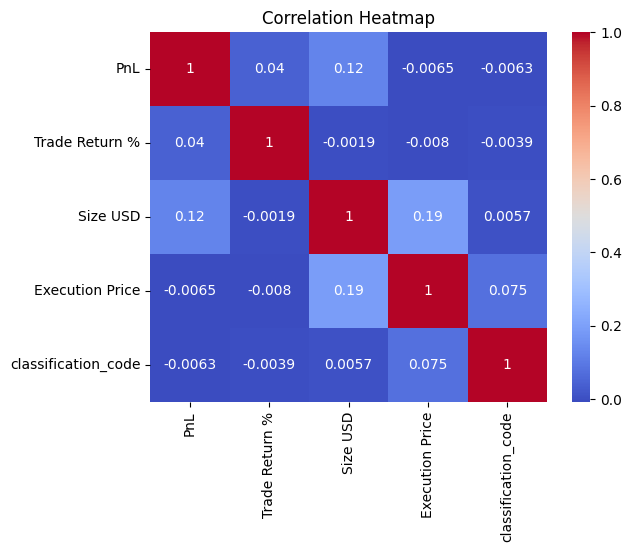

In [26]:
corr_cols = ['PnL', 'Trade Return %', 'Size USD', 'Execution Price', 'classification_code']
correlation_matrix = merged_df[corr_cols].corr()

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

# Pearson and Spearnman Correlations

In [27]:
pearson_corr = merged_df[corr_cols].corr(method='pearson')['classification_code']
spearman_corr = merged_df[corr_cols].corr(method='spearman')['classification_code']

print("Pearson correlation with Sentiment Value:\n", pearson_corr)
print("\nSpearman correlation with Sentiment Value:\n", spearman_corr)

Pearson correlation with Sentiment Value:
 PnL                   -0.006321
Trade Return %        -0.003922
Size USD               0.005682
Execution Price        0.075220
classification_code    1.000000
Name: classification_code, dtype: float64

Spearman correlation with Sentiment Value:
 PnL                   -0.038417
Trade Return %        -0.044973
Size USD              -0.015026
Execution Price        0.087358
classification_code    1.000000
Name: classification_code, dtype: float64


In [28]:
fig_timestamp_classification = px.scatter(merged_df, x='Timestamp', y='PnL', color='classification',title='Sentiment Classification Over Time and PnL')
fig_timestamp_classification.show()

# Scaling the features

In [29]:
from sklearn.preprocessing import StandardScaler

In [30]:
toscale = merged_df[['PnL','Trade Return %', 'Size USD', 'classification_code']].copy().dropna()
scaler = StandardScaler()
scaled_data = scaler.fit_transform(toscale)
display(scaled_data)

array([[-0.05304173, -0.02245764,  0.06100712, -0.98053481],
       [-0.05304173, -0.02245764, -0.15071398, -0.98053481],
       [-0.05304173, -0.02245764, -0.12274824, -0.98053481],
       ...,
       [-0.07745299, -0.07937153, -0.1414605 ,  0.64954227],
       [-0.26058936, -0.07937111, -0.04585237,  0.64954227],
       [-0.11168296, -0.07937097, -0.12359026,  0.64954227]])

# Principal Component Analysis

In [31]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

Explained variance by PCA components: [0.28230723 0.25157268] 




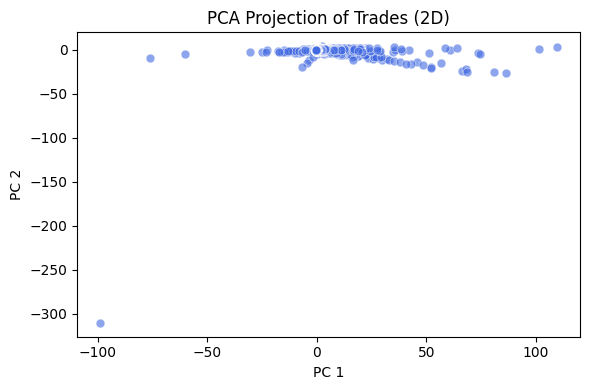

In [32]:
pca = PCA(n_components=2)
pca_data = pca.fit_transform(scaled_data)

explained_variance = pca.explained_variance_ratio_
print(f"Explained variance by PCA components: {explained_variance} \n\n")

# Plot PCA projection
plt.figure(figsize=(6,4))
sns.scatterplot(
    x=pca_data[:, 0], y=pca_data[:, 1],
    alpha=0.6, s=40, color='royalblue'
)
plt.title('PCA Projection of Trades (2D)')
plt.xlabel('PC 1')
plt.ylabel('PC 2')
plt.tight_layout()
plt.show()

# KMeans Clustering

In [33]:
def find_optimal_k(data, max_k=10):
    sse = []
    for k in range(1, max_k + 1):
        kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
        kmeans.fit(data)
        sse.append(kmeans.inertia_)  # Sum of squared distances to closest centroid
    plt.figure(figsize=(8, 4))
    plt.plot(range(1, max_k + 1), sse, marker='o')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('SSE (Inertia)')
    plt.title('Elbow Method for Optimal k')
    plt.grid(True)
    plt.show()

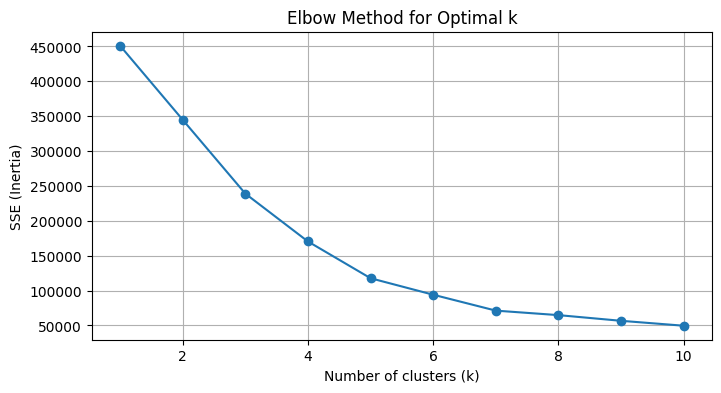

In [34]:
find_optimal_k(pca_data, max_k=10)

In [35]:
k = 5
kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
clusters = kmeans.fit_predict(pca_data)

toscale['PC1'] = pca_data[:, 0]
toscale['PC2'] = pca_data[:, 1]
toscale['Cluster'] = clusters

fig = px.scatter(
    toscale,
    x='PC1',
    y='PC2',
    color='Cluster',
    title=f'KMeans Clustering (k={k}) on PCA-Reduced Features',
    labels={'PC1': 'Principal Component 1', 'PC2': 'Principal Component 2'},
)
fig.update_layout(legend_title='Cluster')
fig.show()

# Modelling

1 = profit ; 0 = loss |

In [36]:
merged_df['Status'] = np.where(merged_df['PnL'] >= 0, 1, 0)
merged_df

,Account,Coin,Execution Price,Size Tokens,Size USD,Side,Start Position,Direction,Crossed,Fee,Timestamp,value,classification,PnL,Trade Return %,classification_code,Status
0,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9769,986.87,7872.16,BUY,0.000000,Buy,True,0.345404,2024-12-02 22:50:00,80,Extreme Greed,0.0000,0.000000,1,1
1,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9800,16.00,127.68,BUY,986.524596,Buy,True,0.005600,2024-12-02 22:50:00,80,Extreme Greed,0.0000,0.000000,1,1
2,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9855,144.09,1150.63,BUY,1002.518996,Buy,True,0.050431,2024-12-02 22:50:00,80,Extreme Greed,0.0000,0.000000,1,1
3,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9874,142.98,1142.04,BUY,1146.558564,Buy,True,0.050043,2024-12-02 22:50:00,80,Extreme Greed,0.0000,0.000000,1,1
4,0xae5eacaf9c6b9111fd53034a602c192a04e082ed,@107,7.9894,8.73,69.75,BUY,1289.488521,Buy,True,0.003055,2024-12-02 22:50:00,80,Extreme Greed,0.0000,0.000000,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211219,0x72743ae2822edd658c0c50608fd7c5c501b2afbd,FARTCOIN,1.1010,382.20,420.80,SELL,7546.600000,Close Long,False,0.042080,2025-04-25 15:35:00,60,Greed,-20.2566,-4.813831,3,0
211220,0x72743ae2822edd658c0c50608fd7c5c501b2afbd,FARTCOIN,1.1010,2124.10,2338.63,SELL,7164.400000,Close Long,False,0.233863,2025-04-25 15:35:00,60,Greed,-112.5773,-4.813814,3,0
211221,0x72743ae2822edd658c0c50608fd7c5c501b2afbd,FARTCOIN,1.1010,423.40,466.16,SELL,5040.300000,Close Long,False,0.046616,2025-04-25 15:35:00,60,Greed,-22.4402,-4.813841,3,0
211222,0x72743ae2822edd658c0c50608fd7c5c501b2afbd,FARTCOIN,1.1010,3599.80,3963.38,SELL,4616.900000,Close Long,False,0.396337,2025-04-25 15:35:00,60,Greed,-190.7894,-4.813805,3,0


#We have a Binary Classification Problem now

In [37]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve, average_precision_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
import lightgbm

from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [38]:
status_counts = merged_df['Status'].value_counts()
status_percentages = merged_df['Status'].value_counts(normalize=True) * 100

print("Counts of Status (1: Profit, 0: Loss):")
print(status_counts)

print("\nPercentages of Status (1: Profit, 0: Loss):")
print(status_percentages)

Counts of Status (1: Profit, 0: Loss):
Status
1    193685
0     17539
Name: count, dtype: int64

Percentages of Status (1: Profit, 0: Loss):
Status
1    91.696493
0     8.303507
Name: proportion, dtype: float64


Well here we have a problem now, there are very few test cases that output status = 0, if we use the dataset as it is to give us output then it's theoretical accuracy would be very high but in reality it wouldn't work properly.

1 -> Profit | 0 -> Loss

#### We can't use features like **PnL** or **Trade Return %** because they will lead to overfitting of the model if you know the PnL then obviously you can tell is status of trade is profit or loss and in live environment we will not know about PnL and Trade Return%

In [39]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import joblib

target = ['Status']
categorical_features = ['Coin', 'Side', 'Direction', 'classification']
numerical_features = ['Execution Price', 'Size Tokens', 'Size USD', 'Start Position', 'Fee']

preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', sparse_output=False), categorical_features)
    ],
    remainder='passthrough',
)

features_array = preprocessor.fit_transform(merged_df[categorical_features + numerical_features])

cat_columns = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_features)
all_cols = list(cat_columns) + numerical_features
features = pd.DataFrame(features_array, columns=all_cols)

joblib.dump(preprocessor, 'preprocessor.pkl')

['preprocessor.pkl']

In [40]:
features

,Coin_@1,Coin_@10,Coin_@100,Coin_@103,Coin_@107,Coin_@109,Coin_@11,Coin_@112,Coin_@113,Coin_@114,...,classification_Extreme Fear,classification_Extreme Greed,classification_Fear,classification_Greed,classification_Neutral,Execution Price,Size Tokens,Size USD,Start Position,Fee
0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,7.9769,986.87,7872.16,0.000000,0.345404
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,7.9800,16.00,127.68,986.524596,0.005600
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,7.9855,144.09,1150.63,1002.518996,0.050431
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,7.9874,142.98,1142.04,1146.558564,0.050043
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,7.9894,8.73,69.75,1289.488521,0.003055
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211219,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.1010,382.20,420.80,7546.600000,0.042080
211220,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.1010,2124.10,2338.63,7164.400000,0.233863
211221,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.1010,423.40,466.16,5040.300000,0.046616
211222,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.1010,3599.80,3963.38,4616.900000,0.396337


balancing the dataset by adding synthetic data so the model can train properly

In [41]:
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=42)

features['Status'] = merged_df['Status']
syntesized_train_data, synthensized_target_data = smote.fit_resample(features[all_cols], features['Status'])

In [42]:
print("Value count of Status in features dataset (original) : ", features['Status'].value_counts())
print("Value count of Status in synthensized_target_data : ", synthensized_target_data.value_counts())

Value count of Status in features dataset (original) :  Status
1    193685
0     17539
Name: count, dtype: int64
Value count of Status in synthensized_target_data :  Status
1    193685
0    193685
Name: count, dtype: int64


Now the data is balanced and can be used for training a model

In [43]:
x_train, x_test, y_train, y_test = train_test_split(syntesized_train_data[all_cols], synthensized_target_data, test_size=0.2, random_state=42)

Training on Logistic Regression
Results:
Accuracy :  0.7560342824689573
Classification Report :
               precision    recall  f1-score   support

           0       0.72      0.84      0.77     38488
           1       0.81      0.67      0.73     38986

    accuracy                           0.76     77474
   macro avg       0.76      0.76      0.75     77474
weighted avg       0.76      0.76      0.75     77474

Confusion Matrix :
 [[32459  6029]
 [12872 26114]]


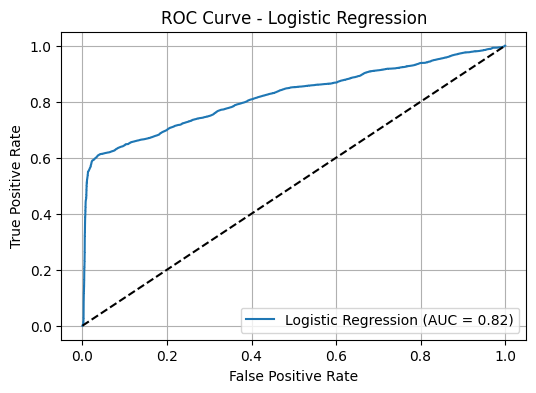

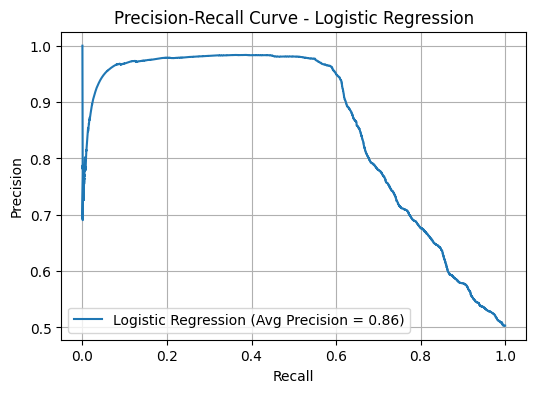



Training on Decision Tree
Results:
Accuracy :  0.9853370162893358
Classification Report :
               precision    recall  f1-score   support

           0       0.98      0.99      0.99     38488
           1       0.99      0.98      0.99     38986

    accuracy                           0.99     77474
   macro avg       0.99      0.99      0.99     77474
weighted avg       0.99      0.99      0.99     77474

Confusion Matrix :
 [[37963   525]
 [  611 38375]]


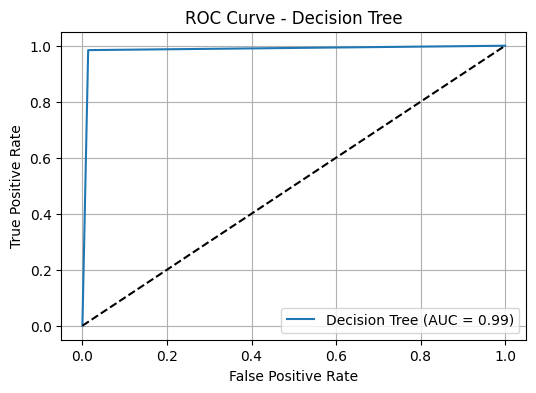

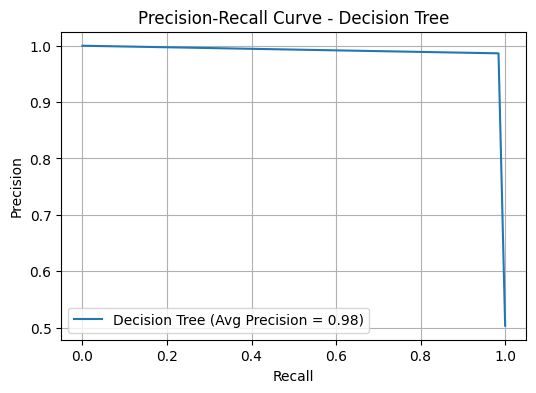



Training on Random Forest
Results:
Accuracy :  0.9871182590288354
Classification Report :
               precision    recall  f1-score   support

           0       0.99      0.99      0.99     38488
           1       0.99      0.99      0.99     38986

    accuracy                           0.99     77474
   macro avg       0.99      0.99      0.99     77474
weighted avg       0.99      0.99      0.99     77474

Confusion Matrix :
 [[37998   490]
 [  508 38478]]


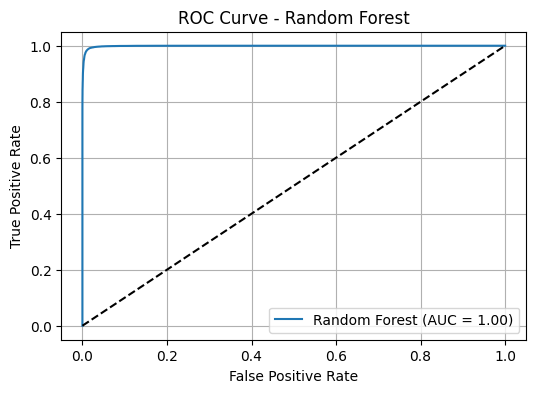

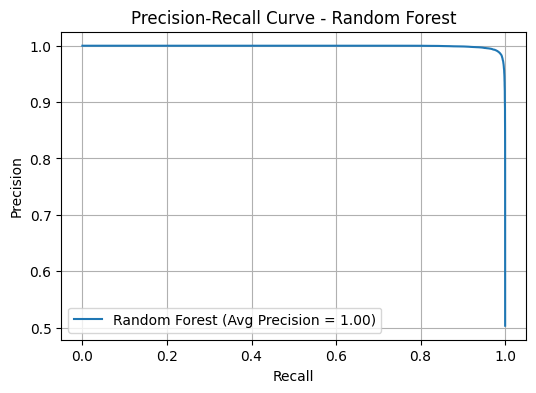



Training on XGBoost
Results:
Accuracy :  0.9452332395384258
Classification Report :
               precision    recall  f1-score   support

           0       0.94      0.95      0.95     38488
           1       0.95      0.94      0.95     38986

    accuracy                           0.95     77474
   macro avg       0.95      0.95      0.95     77474
weighted avg       0.95      0.95      0.95     77474

Confusion Matrix :
 [[36537  1951]
 [ 2292 36694]]


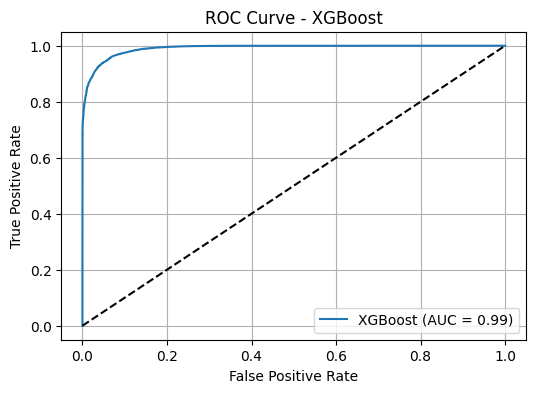

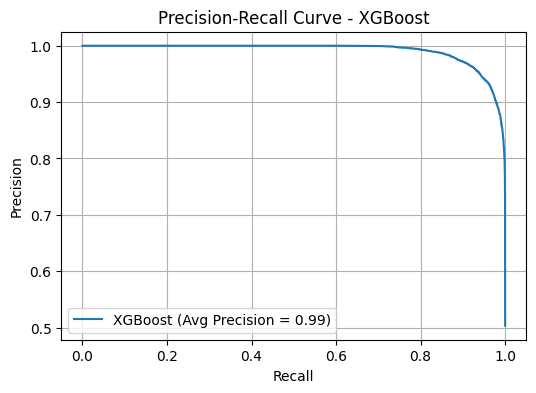



Training on Lightgbm
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 154699, number of negative: 155197
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.361388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16554
[LightGBM] [Info] Number of data points in the train set: 309896, number of used features: 199
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.499197 -> initscore=-0.003214
[LightGBM] [Info] Start training from score -0.003214
Results:
Accuracy :  0.9407672251335932
Classification Report :
               precision    recall  f1-score   support

           0       0.93      0.95      0.94     38488
           1       0.95      0.93      0.94     38986

    accuracy                           0.94     77474
   macro avg       0.94      0.94      0.94     774

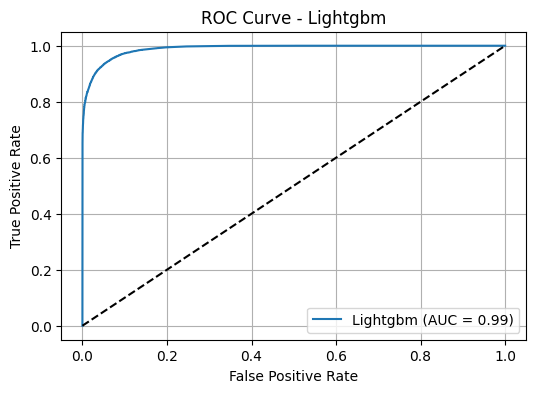

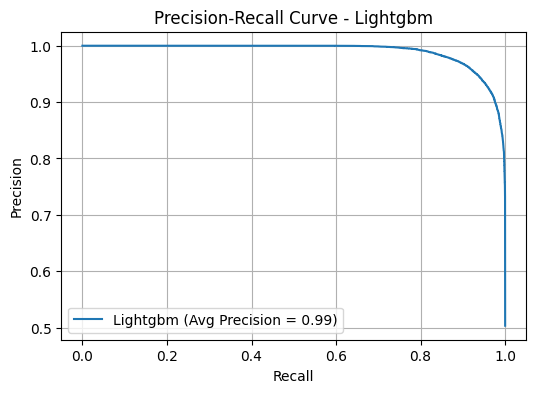

In [44]:
model = {
    'Logistic Regression': LogisticRegression(),  #low performance - accuracy = 75.6%
    'Decision Tree': DecisionTreeClassifier(),    #models are overfitting - accuracy = 98.5%
    'Random Forest': RandomForestClassifier(),    #models are overfitting - accuracy = 98.7%
    'XGBoost': XGBClassifier(),
    'Lightgbm': lightgbm.LGBMClassifier()
}

for key, value in model.items():
  print(f"Training on {key}")
  value.fit(x_train, y_train)
  y_pred = value.predict(x_test)
  print("Results:")
  print("Accuracy : ", accuracy_score(y_test, y_pred))
  print("Classification Report :\n", classification_report(y_test, y_pred))
  print("Confusion Matrix :\n", confusion_matrix(y_test, y_pred))

  y_proba = value.predict_proba(x_test)[:, 1]

  # ROC Curve
  fpr, tpr, _ = roc_curve(y_test, y_proba)
  roc_auc = auc(fpr, tpr)

  plt.figure(figsize=(6, 4))
  plt.plot(fpr, tpr, label=f'{key} (AUC = {roc_auc:.2f})')
  plt.plot([0, 1], [0, 1], 'k--')
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title(f'ROC Curve - {key}')
  plt.legend(loc='lower right')
  plt.grid(True)
  plt.show()

  # Precision-Recall Curve
  precision, recall, _ = precision_recall_curve(y_test, y_proba)
  pr_auc = average_precision_score(y_test, y_proba)

  plt.figure(figsize=(6, 4))
  plt.plot(recall, precision, label=f'{key} (Avg Precision = {pr_auc:.2f})')
  plt.xlabel('Recall')
  plt.ylabel('Precision')
  plt.title(f'Precision-Recall Curve - {key}')
  plt.legend(loc='lower left')
  plt.grid(True)
  plt.show()

  print('\n' + '='*50 + '\n')

*Logistic Regression provided a conservative benchmark, suggesting that the classification task has moderate complexity. XGBoost and LightGBM struck a strong balance between performance and generalizability, whereas Decision Trees and Random Forests may be overfitting. Accuracy was complemented by F1-score, Precision, and Recall to reflect true performance.*

XGBClassifier has given best result for dataset that seems realistic too, so we will take it as base model

# Hyperparameter Tuning using Bayesian Optimization

In [47]:
import optuna
from sklearn.model_selection import cross_val_score

In [48]:
def objective(trial):
  params = {
        'n_estimators': trial.suggest_int('n_estimators', 200, 400),
        'max_depth': trial.suggest_int('max_depth', 8, 12),
        'learning_rate': trial.suggest_float('learning_rate', 0.1, 0.3),
        'subsample': trial.suggest_float('subsample', 0.4, 0.6),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.75, 1.0)
    }

  model = XGBClassifier(**params, use_label_encoder=False, eval_metric='logloss')
  return cross_val_score(model, x_train, y_train, scoring='f1', cv=3).mean()

study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=3)

print("Best parameters:", study.best_params)
print("Best F1 score:", study.best_value)

[I 2025-07-30 05:54:00,773] A new study created in memory with name: no-name-15018ac6-9589-4d32-9bff-b12be044f15f
[I 2025-07-30 05:57:11,535] Trial 0 finished with value: 0.9754787921405484 and parameters: {'n_estimators': 339, 'max_depth': 8, 'learning_rate': 0.2252772169623334, 'subsample': 0.4192236863270893, 'colsample_bytree': 0.9416013029506771}. Best is trial 0 with value: 0.9754787921405484.
[I 2025-07-30 05:59:22,422] Trial 1 finished with value: 0.9774166164973405 and parameters: {'n_estimators': 205, 'max_depth': 10, 'learning_rate': 0.26682677765258567, 'subsample': 0.5190585527105983, 'colsample_bytree': 0.8453404209585142}. Best is trial 1 with value: 0.9774166164973405.
[I 2025-07-30 06:04:21,231] Trial 2 finished with value: 0.9799124058751231 and parameters: {'n_estimators': 347, 'max_depth': 11, 'learning_rate': 0.25405286421105444, 'subsample': 0.43594150089484185, 'colsample_bytree': 0.9420266735085767}. Best is trial 2 with value: 0.9799124058751231.


Best parameters: {'n_estimators': 347, 'max_depth': 11, 'learning_rate': 0.25405286421105444, 'subsample': 0.43594150089484185, 'colsample_bytree': 0.9420266735085767}
Best F1 score: 0.9799124058751231


Results:
Accuracy :  0.9827813201848362
Classification Report :
               precision    recall  f1-score   support

           0       0.98      0.98      0.98     38488
           1       0.98      0.98      0.98     38986

    accuracy                           0.98     77474
   macro avg       0.98      0.98      0.98     77474
weighted avg       0.98      0.98      0.98     77474

Confusion Matrix :
 [[37879   609]
 [  725 38261]]


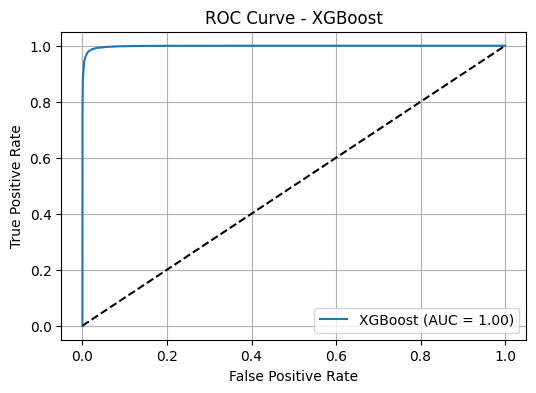

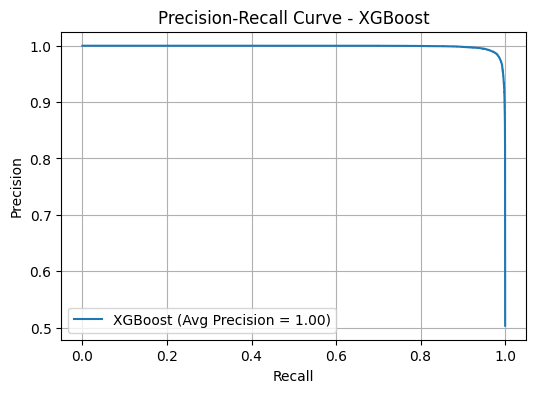

In [49]:
model = XGBClassifier(n_estimators = 347, max_depth = 11, learning_rate = 0.2540, subsample = 0.4359, colsample_bytree = 0.9420)
model.fit(x_train, y_train)
y_pred = model.predict(x_test)

print("Results:")
print("Accuracy : ", accuracy_score(y_test, y_pred))
print("Classification Report :\n", classification_report(y_test, y_pred))
print("Confusion Matrix :\n", confusion_matrix(y_test, y_pred))
y_proba = model.predict_proba(x_test)[:, 1]

# ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(6, 4))
plt.plot(fpr, tpr, label=f'XGBoost (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve - XGBoost')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# Precision-Recall Curve
precision, recall, _ = precision_recall_curve(y_test, y_proba)
pr_auc = average_precision_score(y_test, y_proba)
plt.figure(figsize=(6, 4))
plt.plot(recall, precision, label=f'XGBoost (Avg Precision = {pr_auc:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve - XGBoost')
plt.legend(loc='lower left')
plt.grid(True)
plt.show()

In [50]:
import joblib
joblib.dump(model, 'xgb_model.pkl')

['xgb_model.pkl']